# Integration human pancreas spatial data 

### Import packages

In [1]:
import scanpy as sc
#import squidpy as sq
import scvi
import numpy as np
import pandas as pd

sc.logging.print_header()

/home/aih/sara.jimenez/miniconda3/envs/scvi-env/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


scanpy==1.10.0 anndata==0.10.6 umap==0.5.6 numpy==1.26.4 scipy==1.13.0 pandas==2.2.1 scikit-learn==1.4.1.post1 statsmodels==0.14.1 igraph==0.11.4 pynndescent==0.5.12


In [136]:
!pip install squidpy

  Using cached squidpy-1.4.1-py3-none-any.whl.metadata (8.8 kB)
  Using cached dask_image-2023.8.1-py2.py3-none-any.whl.metadata (23 kB)
  Using cached dask-2024.5.0-py3-none-any.whl.metadata (3.8 kB)
  Using cached matplotlib_scalebar-0.8.1-py2.py3-none-any.whl.metadata (13 kB)
  Using cached omnipath-1.0.8-py3-none-any.whl.metadata (6.5 kB)
  Using cached scikit_image-0.22.0-cp39-cp39-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (13 kB)
  Using cached spatialdata-0.1.2-py3-none-any.whl.metadata (9.3 kB)
  Using cached validators-0.28.1-py3-none-any.whl.metadata (3.6 kB)
  Using cached click-8.1.7-py3-none-any.whl.metadata (3.0 kB)
  Using cached cloudpickle-3.0.0-py3-none-any.whl.metadata (7.0 kB)
  Using cached partd-1.4.2-py3-none-any.whl.metadata (4.6 kB)
  Using cached PIMS-0.6.1-py3-none-any.whl
  Using cached inflect-7.2.1-py3-none-any.whl.metadata (21 kB)
  Using cached wrapt-1.16.0-cp39-cp39-manylinux_2_5_x86_64.manylinux1_x86_64.manylinux_2_17_x86_64.manylinux2014

### Load data  

#### anndata objects per slide (S1, S2, S3) -here slide:=donor- and then integrate per condition (ND and T1D)

In [2]:
folder = '../../../../../../datasets/projects/20230301_Sander_SpatialPancreas_sara.jimenez/spatial/'
files  = ['S1.h5ad','S2.h5ad','S3.h5ad']

adatas  = []
for n in files:
    adata  = sc.read(filename = folder+n)
    adatas.append(adata)
    
adata = adatas[0].concatenate(*adatas[1:], batch_key='slide')
adata

/tmp/ipykernel_39332/255930978.py:9: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata = adatas[0].concatenate(*adatas[1:], batch_key='slide')


AnnData object with n_obs × n_vars = 386727 × 979
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes'
    var: 'NegPrb', 'n_cells_by_counts-0', 'mean_counts-0', 'log1p_mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'log1p_total_counts-0', 'n_cells-0', 'n_cells_by_counts-1', 'mean_counts-1', 'log1p_mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'log1p_total_counts-1', 'n_cells-1', 'n_cells_by_counts-2', 'mean_counts-2', 'log1p_mean_counts-2', 'pct_dropout

Subset according to conditon 

In [3]:
# Non-diabetic samples (ND)
adata_nd = adata[np.isin(adata.obs['condition'],['ND'])].copy()
# Type 1 diabetic samples (t1)
adata_t1 = adata[np.isin(adata.obs['condition'],['T1D'])].copy()
adata_nd, adata_t1

(AnnData object with n_obs × n_vars = 161439 × 979
     obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes'
     var: 'NegPrb', 'n_cells_by_counts-0', 'mean_counts-0', 'log1p_mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'log1p_total_counts-0', 'n_cells-0', 'n_cells_by_counts-1', 'mean_counts-1', 'log1p_mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'log1p_total_counts-1', 'n_cells-1', 'n_cells_by_counts-2', 'mean_counts-2', 'log1p_mean_counts-2', 'pct_drop

### Pre-processing    
The objects are already filtered, normalized and logarithmized 

In [4]:
adata_nd.raw = adata_nd  # freeze the state in `.raw`
adata_t1.raw = adata_t1  # freeze the state in `.raw`

In [5]:
sc.pp.highly_variable_genes(
    adata_nd,
    n_top_genes=2000,
    subset=True,
    layer='counts',
    flavor='seurat_v3',
    batch_key='slide',
)

sc.pp.highly_variable_genes(
    adata_t1,
    n_top_genes=2000,
    subset=True,
    layer='counts',
    flavor='seurat_v3',
    batch_key='slide',
)

### Integration with scVI

In [6]:
!pip install -U "jax[cuda12_pip]" -f https://storage.googleapis.com/jax-releases/jax_cuda_releases.html

/home/aih/sara.jimenez/miniconda3/envs/scvi-env/lib/python3.9/pty.py:85: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


Looking in links: https://storage.googleapis.com/jax-releases/jax_cuda_releases.html
     ━━━╺━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.9/143.6 MB 36.1 MB/s eta 0:00:04ERROR: Could not install packages due to an OSError: [Errno 28] No space left on device

     ━━━╺━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.8/143.6 MB 38.7 MB/s eta 0:00:04


In [7]:
scvi.model.SCVI.setup_anndata(
    adata_nd,
    layer='counts',
    categorical_covariate_keys=['slide']
)

scvi.model.SCVI.setup_anndata(
    adata_t1,
    layer='counts',
    categorical_covariate_keys=['slide']
)

Creating and training the model 

In [8]:
model_nd = scvi.model.SCVI(adata_nd)
model_t1 = scvi.model.SCVI(adata_t1)

In [9]:
model_nd, model_t1

SCVI model with the following parameters: 
n_hidden: 128, n_latent: 10, n_layers: 1, dropout_rate: 0.1, dispersion: gene, gene_likelihood: zinb, 
latent_distribution: normal.
Training status: Not Trained
Model's adata is minified?: False

SCVI model with the following parameters: 
n_hidden: 128, n_latent: 10, n_layers: 1, dropout_rate: 0.1, dispersion: gene, gene_likelihood: zinb, 
latent_distribution: normal.
Training status: Not Trained
Model's adata is minified?: False

(, )

In [10]:
model_nd.train()

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
SLURM auto-requeueing enabled. Setting signal handlers.
/home/aih/sara.jimenez/miniconda3/envs/scvi-env/lib/python3.9/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=3` in the `DataLoader` to improve performance.


Epoch 50/50: 100%|██████████| 50/50 [09:11<00:00, 10.72s/it, v_num=1, train_loss_step=220, train_loss_epoch=240]

`Trainer.fit` stopped: `max_epochs=50` reached.


Epoch 50/50: 100%|██████████| 50/50 [09:11<00:00, 11.04s/it, v_num=1, train_loss_step=220, train_loss_epoch=240]


In [11]:
model_t1.train()

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
SLURM auto-requeueing enabled. Setting signal handlers.
/home/aih/sara.jimenez/miniconda3/envs/scvi-env/lib/python3.9/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=3` in the `DataLoader` to improve performance.


Epoch 36/36: 100%|██████████| 36/36 [09:05<00:00, 15.19s/it, v_num=1, train_loss_step=300, train_loss_epoch=315]

`Trainer.fit` stopped: `max_epochs=36` reached.


Epoch 36/36: 100%|██████████| 36/36 [09:05<00:00, 15.16s/it, v_num=1, train_loss_step=300, train_loss_epoch=315]


Obtaining model outputs

In [12]:
latent_nd = model_nd.get_latent_representation()
latent_t1 = model_t1.get_latent_representation()

In [13]:
adata_nd.obsm['X_scVI'] = latent_nd
adata_t1.obsm['X_scVI'] = latent_t1

In [14]:
adata_nd.layers['scvi_normalized'] = model_nd.get_normalized_expression(library_size=10e4)
adata_t1.layers['scvi_normalized'] = model_t1.get_normalized_expression(library_size=10e4)

Visualization with batch correction 

In [15]:
sc.pp.neighbors(adata_nd, use_rep='X_scVI')
sc.tl.umap(adata_nd, min_dist=0.3)

sc.pp.neighbors(adata_t1, use_rep='X_scVI')
sc.tl.umap(adata_t1, min_dist=0.3)

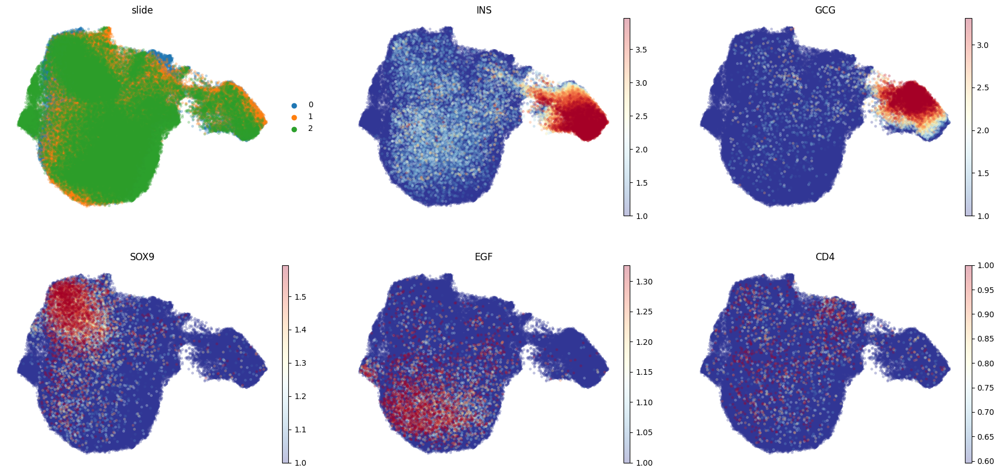

In [16]:
sc.pl.umap(
    adata_nd,
    color=['slide','INS','GCG','SOX9','EGF','CD4'],
    ncols=3,size=50,vmin=1.0,vmax='p99',alpha=0.3,frameon=False,cmap='RdYlBu_r'
)

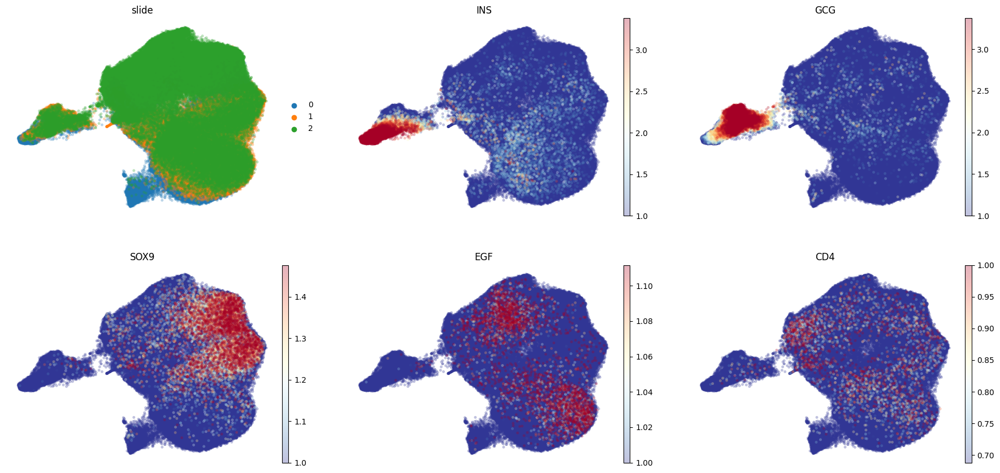

In [17]:
sc.pl.umap(
    adata_t1,
    color=['slide','INS','GCG','SOX9','EGF','CD4'],
    ncols=3,size=50,vmin=1.0,vmax='p99',alpha=0.3,frameon=False,cmap='RdYlBu_r'
)

### Cell cycle score

In [18]:
cell_cycle_genes = [x.strip() for x in open('../../../utils/gene_sets/regev_lab_cell_cycle_genes.txt')]
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
#cell_cycle_genes = [x for x in cell_cycle_genes if x in adata_nd.var_names]
sc.tl.score_genes_cell_cycle(adata_nd, s_genes=s_genes, g2m_genes=g2m_genes)
sc.tl.score_genes_cell_cycle(adata_t1, s_genes=s_genes, g2m_genes=g2m_genes)

       'DTL', 'PRIM1', 'UHRF1', 'MLF1IP', 'HELLS', 'RFC2', 'RPA2', 'NASP',
       'RAD51AP1', 'GMNN', 'WDR76', 'SLBP', 'CCNE2', 'UBR7', 'POLD3', 'MSH2',
       'ATAD2', 'RRM2', 'CDC45', 'CDC6', 'EXO1', 'TIPIN', 'DSCC1', 'BLM',
       'CASP8AP2', 'USP1', 'CLSPN', 'POLA1', 'CHAF1B', 'BRIP1', 'E2F8'],
      dtype='object')
       'TACC3', 'FAM64A', 'SMC4', 'CCNB2', 'CKAP2L', 'CKAP2', 'AURKB', 'BUB1',
       'KIF11', 'ANP32E', 'GTSE1', 'KIF20B', 'HJURP', 'CDCA3', 'HN1', 'CDC20',
       'TTK', 'CDC25C', 'KIF2C', 'RANGAP1', 'NCAPD2', 'DLGAP5', 'CDCA2',
       'CDCA8', 'ECT2', 'KIF23', 'HMMR', 'AURKA', 'PSRC1', 'ANLN', 'LBR',
       'CKAP5', 'CENPE', 'CTCF', 'NEK2', 'G2E3', 'GAS2L3', 'CBX5', 'CENPA'],
      dtype='object')
       'DTL', 'PRIM1', 'UHRF1', 'MLF1IP', 'HELLS', 'RFC2', 'RPA2', 'NASP',
       'RAD51AP1', 'GMNN', 'WDR76', 'SLBP', 'CCNE2', 'UBR7', 'POLD3', 'MSH2',
       'ATAD2', 'RRM2', 'CDC45', 'CDC6', 'EXO1', 'TIPIN', 'DSCC1', 'BLM',
       'CASP8AP2', 'USP1', 'CLSPN', 'POLA1', 'C

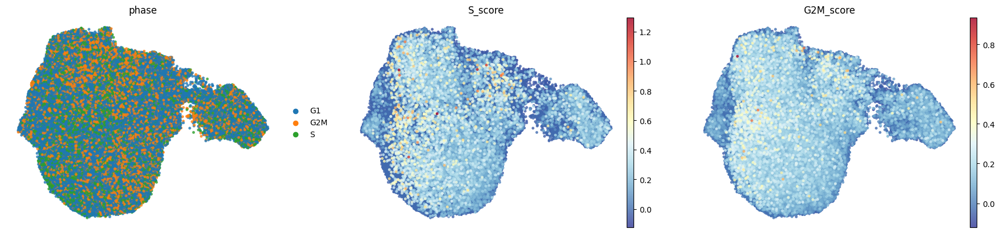

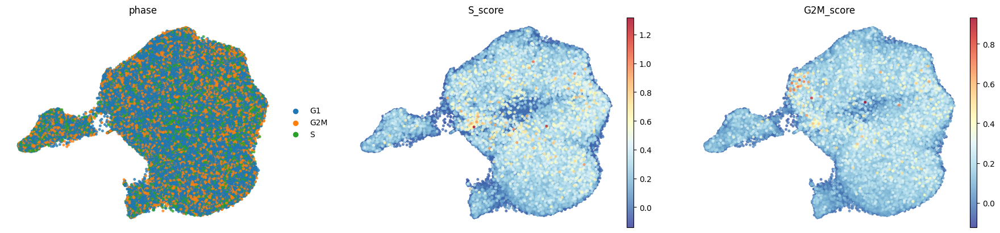

In [19]:
sc.pl.umap(adata_nd, color=['phase','S_score','G2M_score'],frameon=False,cmap='RdYlBu_r',size=50,alpha=.8)
sc.pl.umap(adata_t1, color=['phase','S_score','G2M_score'], frameon=False,cmap='RdYlBu_r',size=50,alpha=.8)

### Clustering on the scVI latent space

In [24]:
resolution = np.array([0.3,0.4,0.5,0.6,0.7])

for r in resolution:
    sc.tl.leiden(adata_nd, key_added='leiden_scVI_r'+str(r), resolution=r,flavor='igraph', n_iterations=2)
    print(r)

0.3
0.4
0.5
0.6
0.7


In [22]:
resolution = np.array([0.3,0.4,0.5,0.6,0.7])
for r in resolution:
    sc.tl.leiden(adata_t1, key_added='leiden_scVI_r'+str(r), resolution=r, flavor='igraph', n_iterations=2)
    print(r)

0.3
0.4
0.5
0.6
0.7


### Data Exploration

Clustering of ND samples

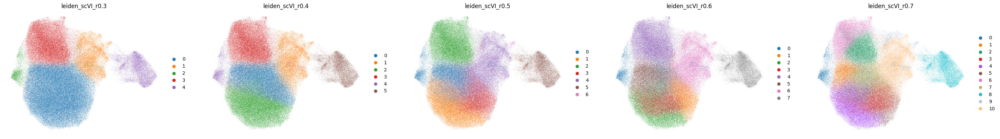

In [28]:
sc.pl.umap(
    adata_nd,
    color=['leiden_scVI_r0.3','leiden_scVI_r0.4','leiden_scVI_r0.5',
           'leiden_scVI_r0.6','leiden_scVI_r0.7'],
    frameon=False,ncols=5
)

Clustering of T1D samples

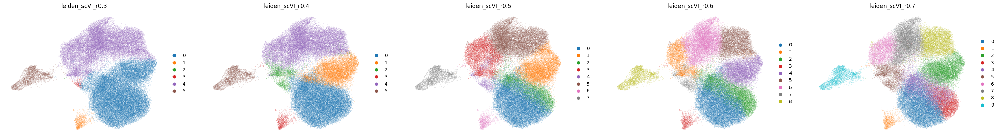

In [23]:
sc.pl.umap(
    adata_t1,
    color=['leiden_scVI_r0.3','leiden_scVI_r0.4','leiden_scVI_r0.5',
           'leiden_scVI_r0.6','leiden_scVI_r0.7'],
    frameon=False,ncols=5
)

### Exploring known marker genes

In [29]:
marker_genes = {
    'Beta' : ['INS','IAPP','NKX6-1','PDX1','MAFA','NKX2-2','FOXA1','FOXA2','GCK'],
    'Alpha' : ['GCG','PAPPA2','IRX2','SLC7A2','TTR','PCSK2','ARX','DNMT1'],
    'Delta' : ['SST','HHEX','ISL1','RBP4','SYT1'],
    'PP' : ['ETV1','ID1','ID3'],
    'Ductal' : ['SOX9','KRT19','MUC1','CA2','SOX4','SPP1'],
    'Acinar' : ['CPA1','PRSS1','CTRB1','PNLIP','AMY2A','OLFM4','EGF','DLL1','JAG1'],
    'Pancreatic ephitelium' : ['FGFR2','EPCAM'], 
    'Fibroblasts' : ['VIM','COL1A1','COL3A1','ACTA2','FN1','MGP'],
    'Endothelial' : ['PECAM1','VWF','CD34','ENG'],
    'Lymphatic' : ['PROX1','FLT4'],
    'Immune' : ['CD4','CD8A','CD8B', # T cells
                'CD22','CD163','MERTK','MSR1','STAT1','IFNAR1','IRF7','CD83',
                'ITGB2','C1QB','IL1B','STAT1', # Macrophages
                'MS4A1','CD19', # B cells
                'FOXP3',], # T reg cells
    'MTE' : ['CDH1','CK8', 'CK18', 'CK19','CLDN1','CLDN4','OCLN','MUC1','MUC4','MUC5AC','AQP1'],
    'Mast': ['CPA3','TPSAB1']
}

ND samples

In [30]:
marker_genes_in_data = dict()
for ct, markers in marker_genes.items():
    markers_found = list()
    for marker in markers:
        if marker in adata_t1.var.index:
            markers_found.append(marker)
    marker_genes_in_data[ct] = markers_found

In [31]:
pancreatic_ct = [
    'Beta',
    'Alpha',
    'Delta',
    #'PP',
    'Ductal',
    'Acinar',
    'Pancreatic ephitelium',
    'MTE',
    'Fibroblasts',
    'Endothelial',
    #'Lymphatic',
    'Immune',
    'Mast'
]

BETA:


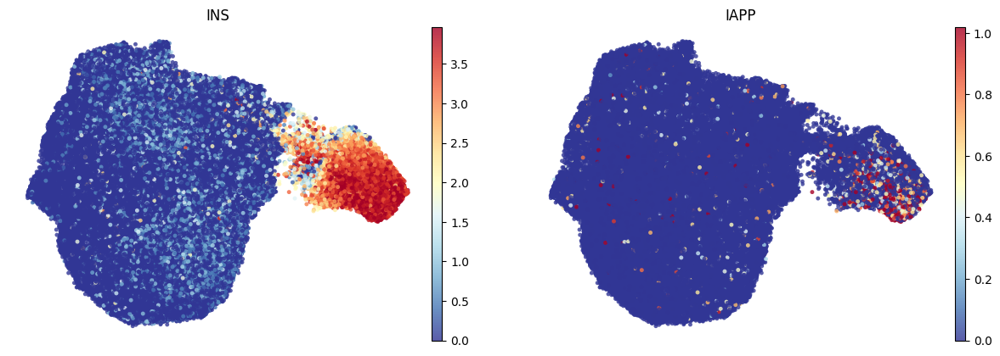





ALPHA:


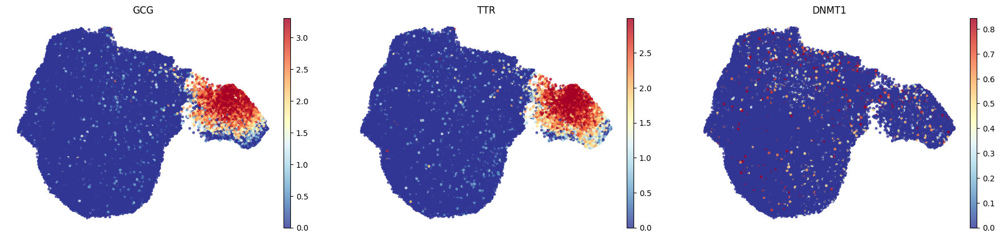





DELTA:


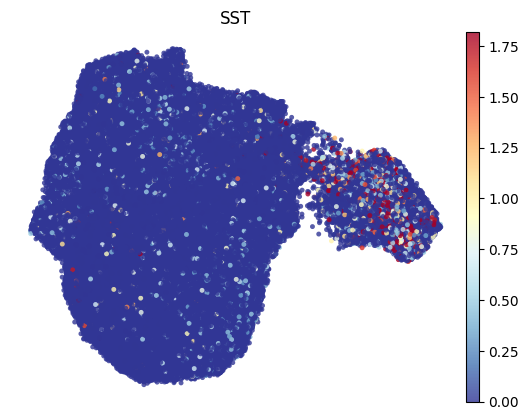





DUCTAL:


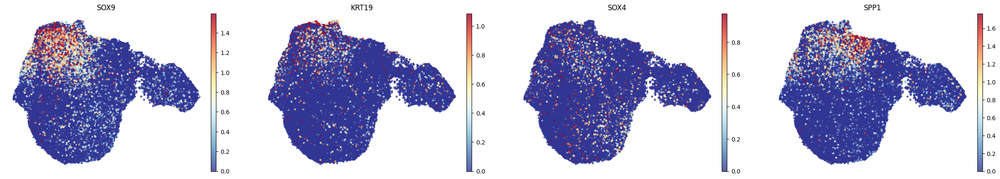





ACINAR:


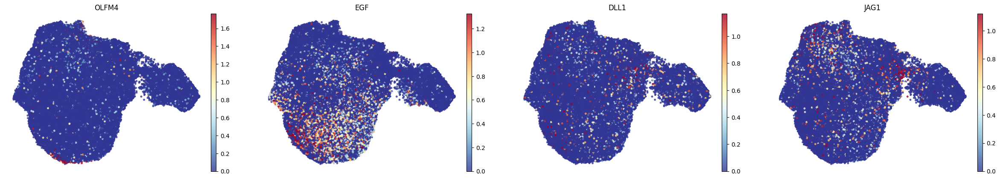





PANCREATIC EPHITELIUM:


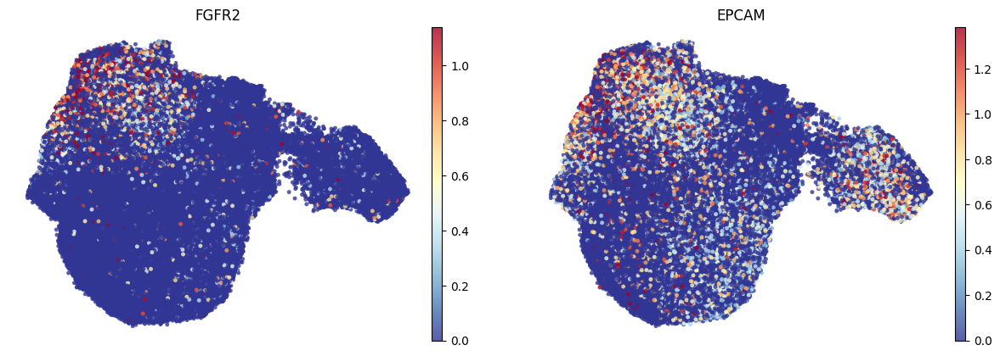





MTE:


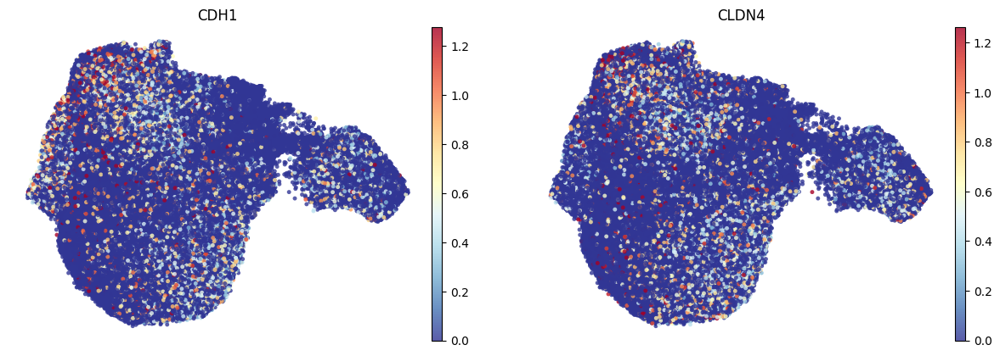





FIBROBLASTS:


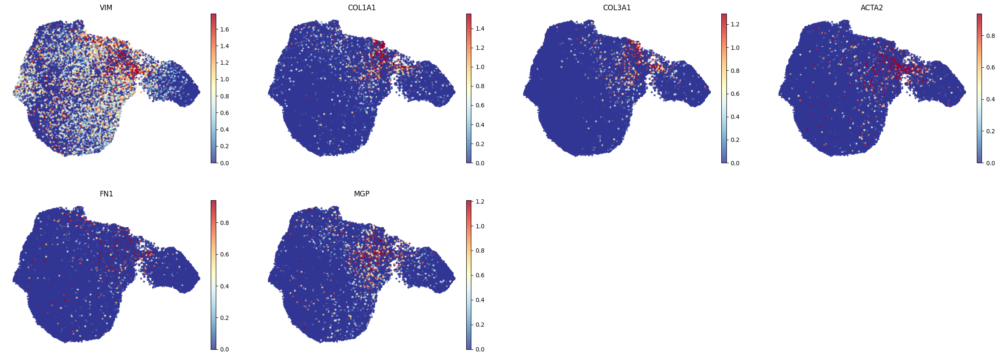





ENDOTHELIAL:


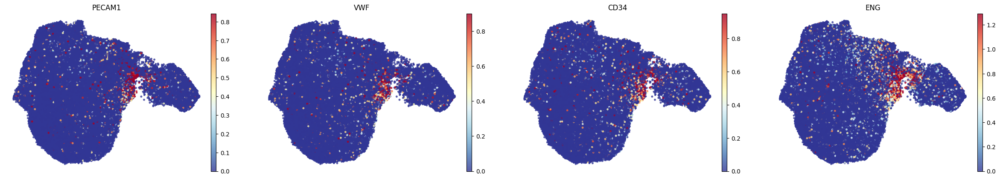





IMMUNE:


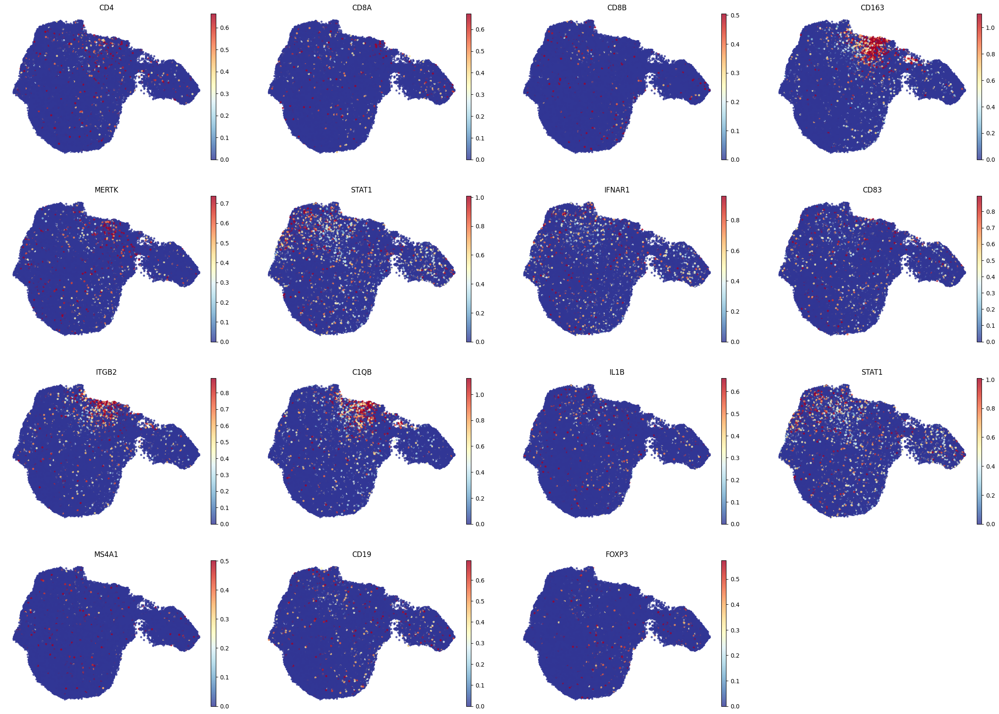





MAST:


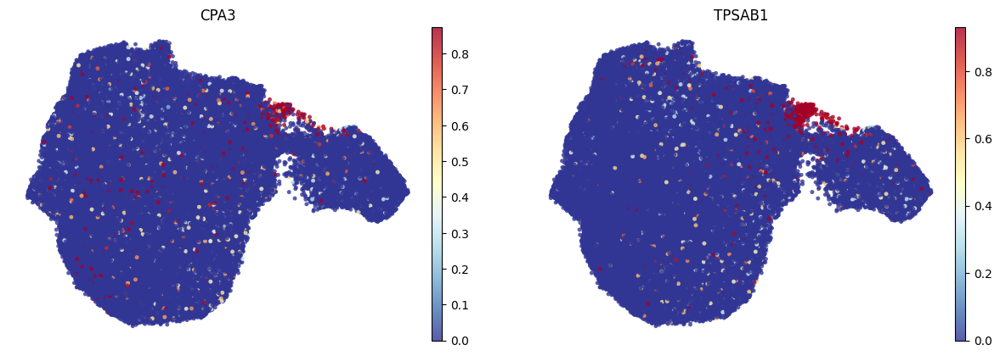

In [32]:
for ct in pancreatic_ct:
    print(f'{ct.upper()}:')  # print cell subtype name
    sc.pl.umap(
        adata_nd,
        color=marker_genes_in_data[ct],
        vmin=0,
        vmax='p99',  # set vmax to the 99th percentile of the gene count instead of the maximum, to prevent outliers from making expression in other cells invisible. Note that this can cause problems for extremely lowly expressed genes.
        sort_order=False,  # do not plot highest expression on top, to not get a biased view of the mean expression among cells
        frameon=False,
        cmap='RdYlBu_r',  # or choose another color map e.g. from here: https://matplotlib.org/stable/tutorials/colors/colormaps.html
        alpha=0.8,
        size=50
    )
    print('\n\n\n')  # print white space for legibility

In [33]:
pancreatic_markers = {
    ct: [m for m in ct_markers if m in adata_nd.var.index]
    for ct, ct_markers in marker_genes.items()
    if ct in pancreatic_ct
}
pancreatic_markers

{'Beta': ['INS', 'IAPP'],
 'Alpha': ['GCG', 'TTR', 'DNMT1'],
 'Delta': ['SST'],
 'Ductal': ['SOX9', 'KRT19', 'SOX4', 'SPP1'],
 'Acinar': ['OLFM4', 'EGF', 'DLL1', 'JAG1'],
 'Pancreatic ephitelium': ['FGFR2', 'EPCAM'],
 'Fibroblasts': ['VIM', 'COL1A1', 'COL3A1', 'ACTA2', 'FN1', 'MGP'],
 'Endothelial': ['PECAM1', 'VWF', 'CD34', 'ENG'],
 'Immune': ['CD4',
  'CD8A',
  'CD8B',
  'CD163',
  'MERTK',
  'STAT1',
  'IFNAR1',
  'CD83',
  'ITGB2',
  'C1QB',
  'IL1B',
  'STAT1',
  'MS4A1',
  'CD19',
  'FOXP3'],
 'MTE': ['CDH1', 'CLDN4'],
 'Mast': ['CPA3', 'TPSAB1']}

categories: 0, 1, 2, etc.
var_group_labels: Beta, Alpha, Delta, etc.


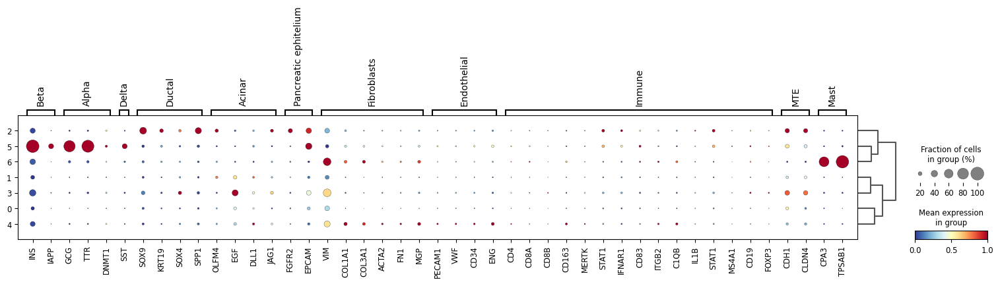

In [39]:
sc.pl.dotplot(
    adata_nd,
    groupby='leiden_scVI_r0.5',
    var_names=pancreatic_markers,
    standard_scale='var',  # standard scale: normalize each gene to range from 0 to 1
    color_map='RdYlBu_r',
    dendrogram=True,
)

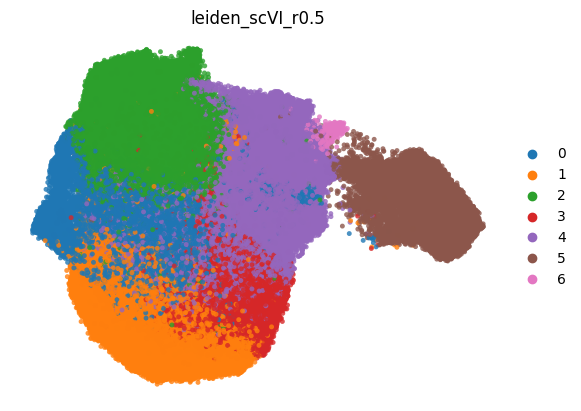

In [40]:
sc.pl.umap(adata_nd, color='leiden_scVI_r0.5', alpha=.8,size=50,frameon=False)

In [41]:
resolution = np.array([0.1,0.3,0.5,0.7,0.9])
for r in resolution:
    sc.tl.leiden(adata_nd, key_added='leiden_scVI_r0.5_'+str(r),
                 restrict_to=('leiden_scVI_r0.5', ['4','5']), resolution=r,flavor='igraph', n_iterations=2)

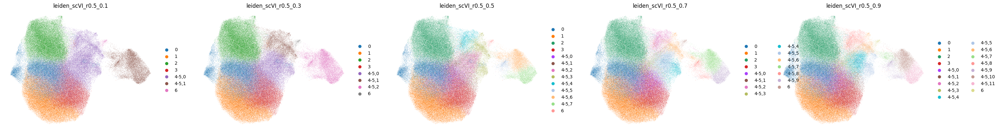

In [42]:
sc.pl.umap(
    adata_nd,
    color=['leiden_scVI_r0.5_0.1','leiden_scVI_r0.5_0.3','leiden_scVI_r0.5_0.5',
          'leiden_scVI_r0.5_0.7','leiden_scVI_r0.5_0.9'],
    frameon=False,ncols=5
)

categories: 0, 1, 2, etc.
var_group_labels: Beta, Alpha, Delta, etc.


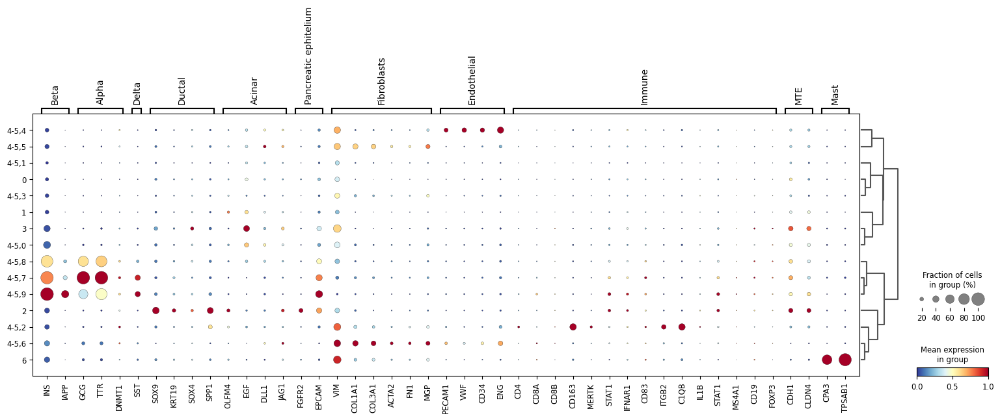

In [44]:
sc.pl.dotplot(
    adata_nd,
    groupby='leiden_scVI_r0.5_0.7',
    var_names=pancreatic_markers,
    standard_scale='var',  # standard scale: normalize each gene to range from 0 to 1
    color_map='RdYlBu_r',
    dendrogram=True,
)

T1D samples

In [67]:
marker_genes_in_data = dict()
for ct, markers in marker_genes.items():
    markers_found = list()
    for marker in markers:
        if marker in adata_t1.var.index:
            markers_found.append(marker)
    marker_genes_in_data[ct] = markers_found

BETA:


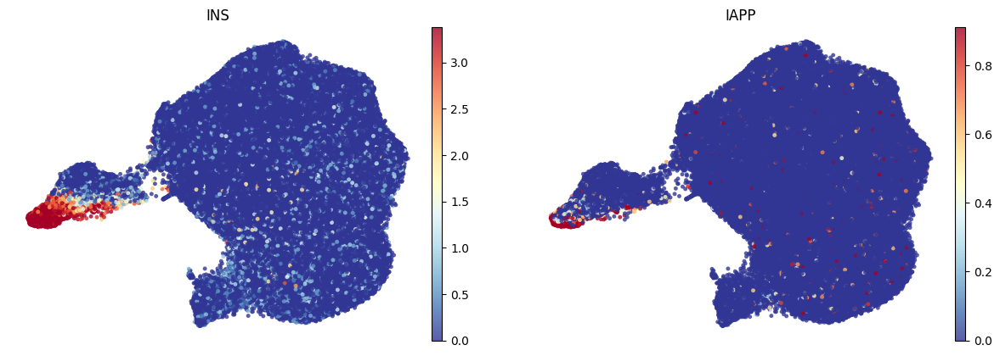





ALPHA:


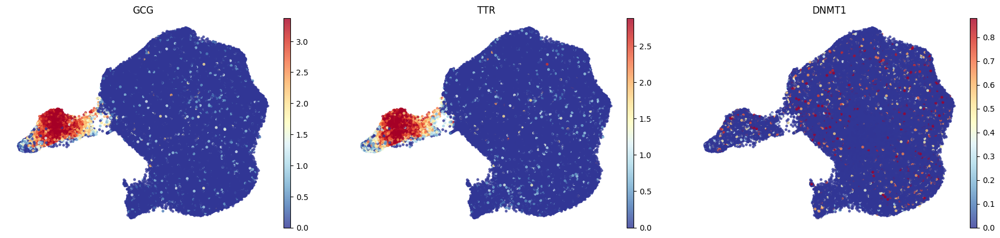





DELTA:


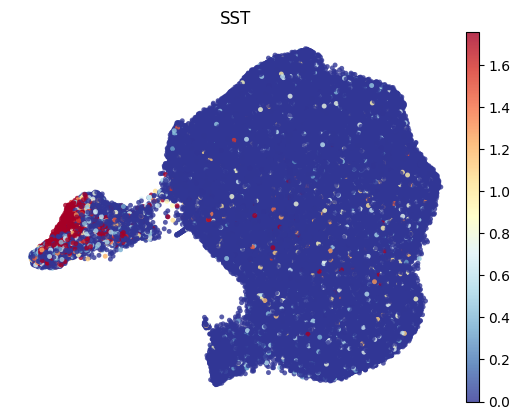





DUCTAL:


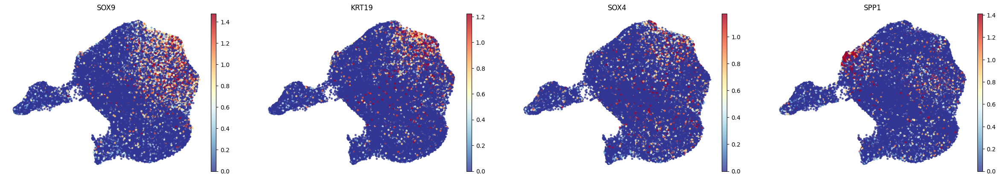





ACINAR:


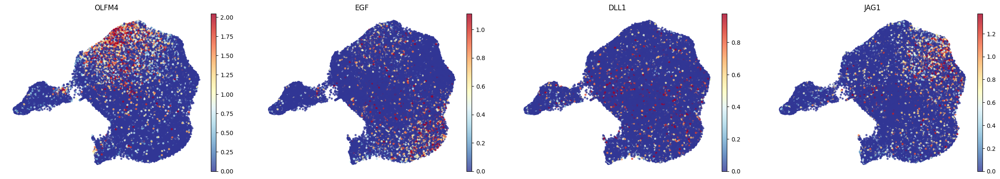





PANCREATIC EPHITELIUM:


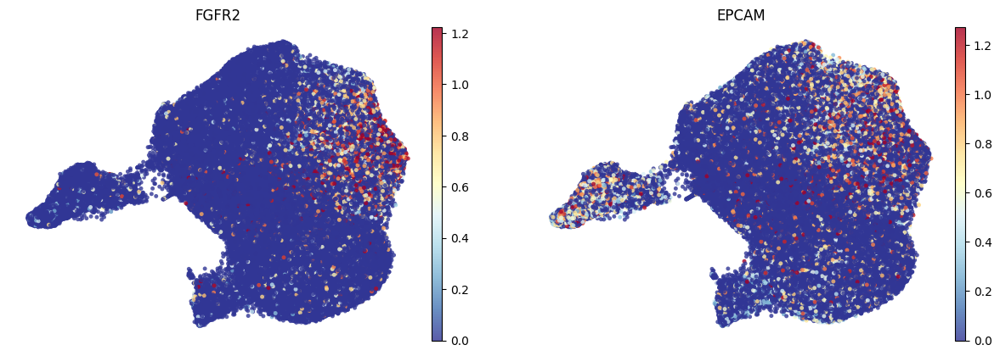





MTE:


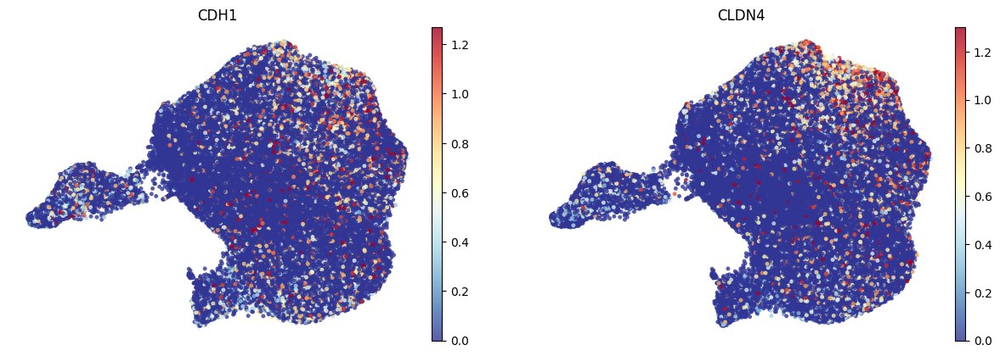





FIBROBLASTS:


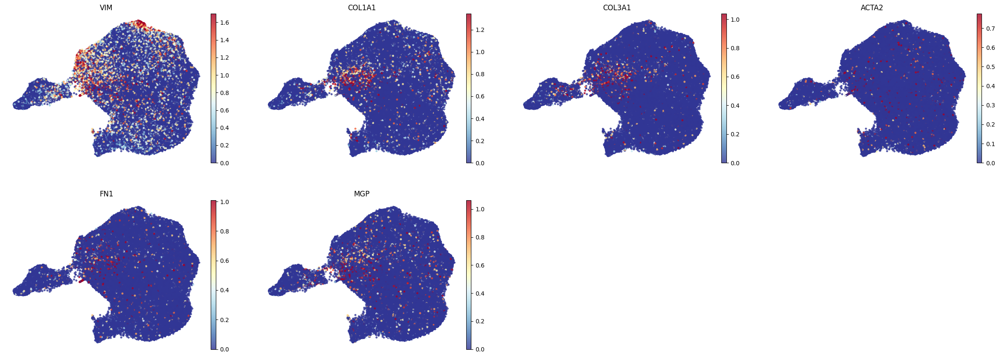





ENDOTHELIAL:


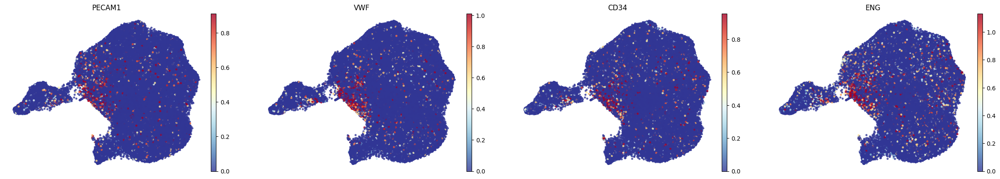





IMMUNE:


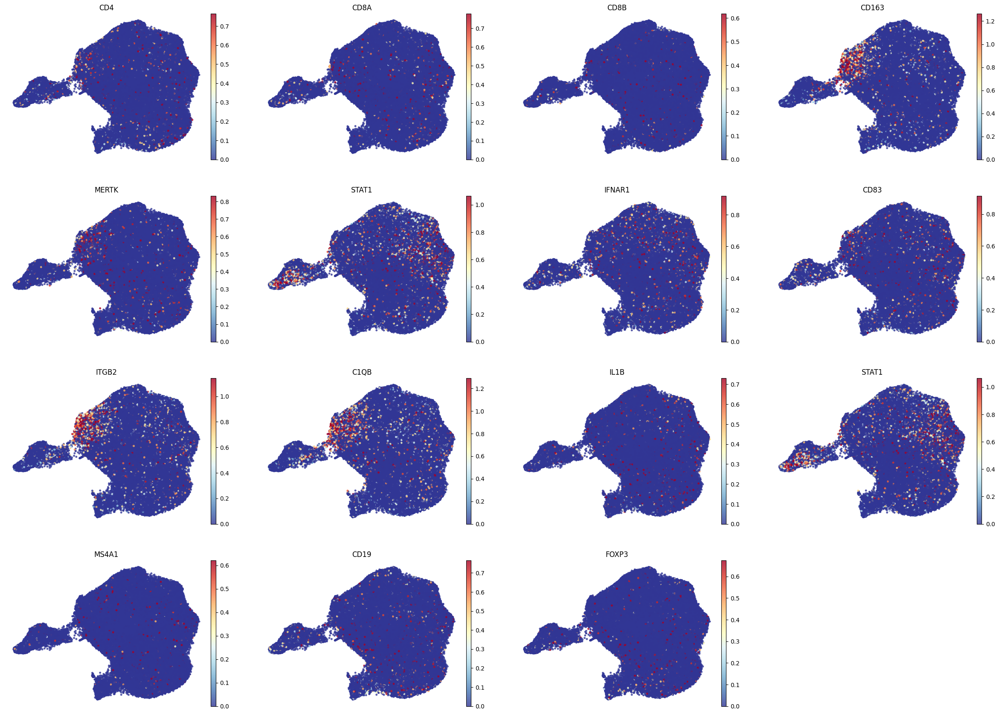





MAST:


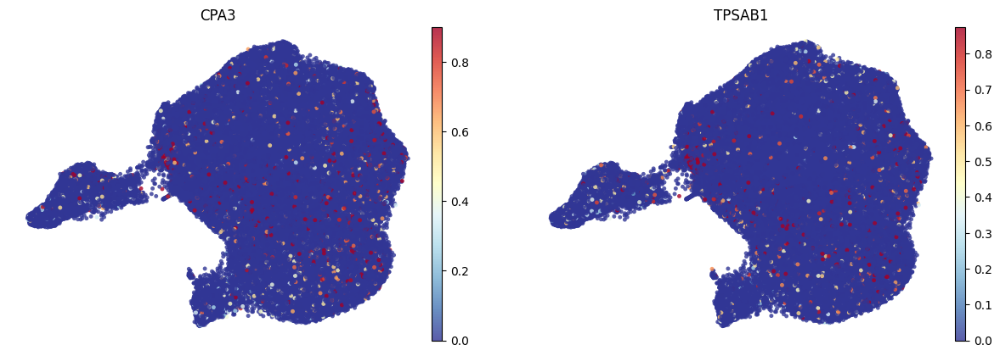

In [68]:
for ct in pancreatic_ct:
    print(f'{ct.upper()}:')  # print cell subtype name
    sc.pl.umap(
        adata_t1,
        color=marker_genes_in_data[ct],
        vmin=0,
        vmax='p99',  # set vmax to the 99th percentile of the gene count instead of the maximum, to prevent outliers from making expression in other cells invisible. Note that this can cause problems for extremely lowly expressed genes.
        sort_order=False,  # do not plot highest expression on top, to not get a biased view of the mean expression among cells
        frameon=False,
        cmap='RdYlBu_r',  # or choose another color map e.g. from here: https://matplotlib.org/stable/tutorials/colors/colormaps.html
        alpha=0.8,
        size=50
    )
    print('\n\n\n')  # print white space for legibility

In [69]:
pancreatic_markers = {
    ct: [m for m in ct_markers if m in adata_t1.var.index]
    for ct, ct_markers in marker_genes.items()
    if ct in pancreatic_ct
}
pancreatic_markers

{'Beta': ['INS', 'IAPP'],
 'Alpha': ['GCG', 'TTR', 'DNMT1'],
 'Delta': ['SST'],
 'Ductal': ['SOX9', 'KRT19', 'SOX4', 'SPP1'],
 'Acinar': ['OLFM4', 'EGF', 'DLL1', 'JAG1'],
 'Pancreatic ephitelium': ['FGFR2', 'EPCAM'],
 'Fibroblasts': ['VIM', 'COL1A1', 'COL3A1', 'ACTA2', 'FN1', 'MGP'],
 'Endothelial': ['PECAM1', 'VWF', 'CD34', 'ENG'],
 'Immune': ['CD4',
  'CD8A',
  'CD8B',
  'CD163',
  'MERTK',
  'STAT1',
  'IFNAR1',
  'CD83',
  'ITGB2',
  'C1QB',
  'IL1B',
  'STAT1',
  'MS4A1',
  'CD19',
  'FOXP3'],
 'MTE': ['CDH1', 'CLDN4'],
 'Mast': ['CPA3', 'TPSAB1']}

categories: 0, 1, 2, etc.
var_group_labels: Beta, Alpha, Delta, etc.


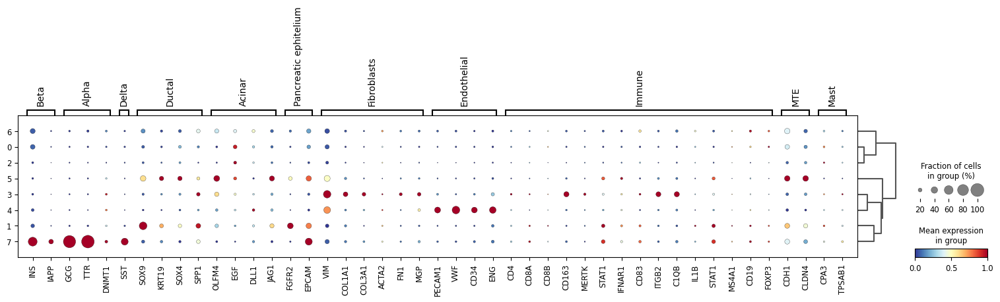

In [70]:
sc.pl.dotplot(
    adata_t1,
    groupby='leiden_scVI_r0.5',
    var_names=pancreatic_markers,
    standard_scale='var',  # standard scale: normalize each gene to range from 0 to 1
    color_map='RdYlBu_r',
    dendrogram=True,
)

In [71]:
resolution = np.array([0.1,0.3,0.5,0.7,0.9])
for r in resolution:
    sc.tl.leiden(adata_t1, key_added='leiden_scVI_r0.5_'+str(r),
                 restrict_to=('leiden_scVI_r0.5', ['3','7']), resolution=r,flavor='igraph', n_iterations=2)

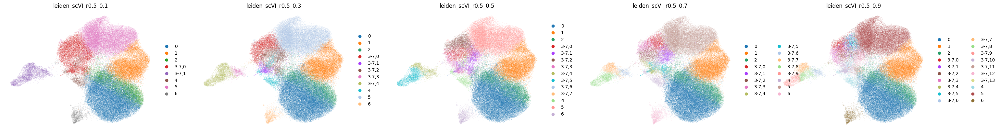

In [72]:
sc.pl.umap(
    adata_t1,
    color=['leiden_scVI_r0.5_0.1','leiden_scVI_r0.5_0.3','leiden_scVI_r0.5_0.5',
          'leiden_scVI_r0.5_0.7','leiden_scVI_r0.5_0.9'],
    frameon=False,ncols=5
)

categories: 0, 1, 2, etc.
var_group_labels: Beta, Alpha, Delta, etc.


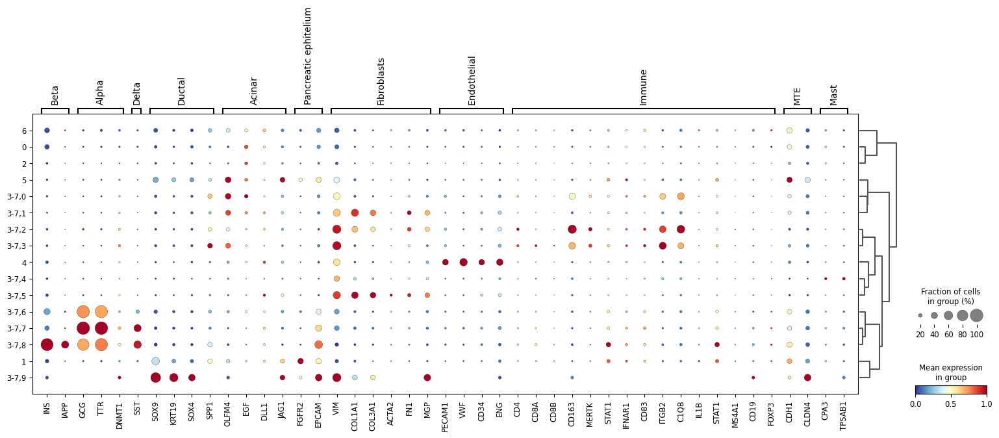

In [73]:
sc.pl.dotplot(
    adata_t1,
    groupby='leiden_scVI_r0.5_0.7',
    var_names=pancreatic_markers,
    standard_scale='var',  # standard scale: normalize each gene to range from 0 to 1
    color_map='RdYlBu_r',
    dendrogram=True,
)

### Cell type annotation

ND samples

In [81]:
adata_nd.obs['leiden_scVI_r0.5_0.7'].cat.categories

Index(['0', '1', '2', '3', '4-5,0', '4-5,1', '4-5,2', '4-5,3', '4-5,4',
       '4-5,5', '4-5,6', '4-5,7', '4-5,8', '4-5,9', '6'],
      dtype='object')

In [85]:
cluster2annotation = {
    '0'     : 'Acinar',
    '1'     : 'Acinar',
    '2'     : 'Ductal',
    '3'     : 'Acinar',
    '4-5,0' : 'Acinar',
    '4-5,1' : 'Acinar',
    '4-5,2' : 'Immune',
    '4-5,3' : 'Fibroblasts',
    '4-5,4' : 'Endothelial',
    '4-5,5' : 'Fibroblasts',
    '4-5,6' : 'Fibroblasts',
    '4-5,7' : 'Alpha',
    '4-5,8' : 'Endocrine',
    '4-5,9' : 'Beta',
    '6'     : 'Mast'
}

adata_nd.obs['cell_type_coarse'] = adata_nd.obs['leiden_scVI_r0.5_0.7'].map(cluster2annotation).astype('category')

adata_nd.obs['cell_type_coarse'].cat.reorder_categories(['Acinar','Alpha','Beta','Ductal','Endocrine','Endothelial',
                                                         'Fibroblasts','Immune','Mast'])#,inplace=True)

1_12-0       Acinar
2_12-0       Acinar
3_12-0       Ductal
4_12-0       Ductal
5_12-0       Ductal
              ...  
5006_24-2    Acinar
5007_24-2    Acinar
5008_24-2    Acinar
5009_24-2    Acinar
5010_24-2    Acinar
Name: cell_type_coarse, Length: 161439, dtype: category
Categories (9, object): ['Acinar', 'Alpha', 'Beta', 'Ductal', ..., 'Endothelial', 'Fibroblasts', 'Immune', 'Mast']

In [97]:
adata_nd.uns['cell_type_coarse_colors'] = [
    '#edd892', #acinar
    '#219ebc', #alpha
    '#adc178', #beta
    '#f79824', #ductal
    '#718355', #endocrine
    '#f15156', #endothelial
    '#bbd0ff', #Fibroblasts
    '#979dac', #Immune
    '#f7c59f'  #mast
]

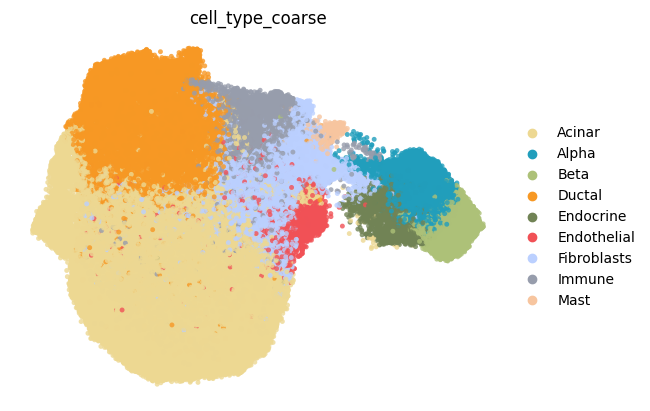

In [98]:
sc.pl.umap(
    adata_nd,
    color=['cell_type_coarse'],
    frameon=False,ncols=1,edges_color=True,size=50,alpha=.8
)

T1D samples

In [88]:
adata_t1.obs['leiden_scVI_r0.5_0.7'].cat.categories

Index(['0', '1', '2', '3-7,0', '3-7,1', '3-7,2', '3-7,3', '3-7,4', '3-7,5',
       '3-7,6', '3-7,7', '3-7,8', '3-7,9', '4', '5', '6'],
      dtype='object')

In [93]:
cluster2annotation = {
    '0'     : 'Acinar',
    '1'     : 'Ductal',
    '2'     : 'Acinar',
    '3-7,0' : 'Ductal',
    '3-7,1' : 'Fibroblasts',
    '3-7,2' : 'Immune',
    '3-7,3' : 'Immune',
    '3-7,4' : 'Mast',
    '3-7,5' : 'Fibroblasts',
    '3-7,6' : 'Endocrine',
    '3-7,7' : 'Alpha',
    '3-7,8' : 'Beta',
    '3-7,9' : 'Ductal',
    '4'     : 'Endothelial',
    '5'     : 'Ductal',
    '6'     : 'Acinar'
}

adata_t1.obs['cell_type_coarse'] = adata_t1.obs['leiden_scVI_r0.5_0.7'].map(cluster2annotation).astype('category')

adata_t1.obs['cell_type_coarse'].cat.reorder_categories(['Acinar','Alpha','Beta','Ductal','Endocrine','Endothelial',
                                                         'Fibroblasts','Immune','Mast'])#,inplace=True)

1_1-0        Acinar
2_1-0        Acinar
3_1-0        Acinar
4_1-0        Acinar
5_1-0        Acinar
              ...  
7236_25-2    Ductal
7237_25-2    Acinar
7239_25-2    Ductal
7240_25-2      Mast
7241_25-2    Ductal
Name: cell_type_coarse, Length: 225288, dtype: category
Categories (9, object): ['Acinar', 'Alpha', 'Beta', 'Ductal', ..., 'Endothelial', 'Fibroblasts', 'Immune', 'Mast']

In [99]:
adata_t1.uns['cell_type_coarse_colors'] = [
    '#edd892', #acinar
    '#219ebc', #alpha
    '#adc178', #beta
    '#f79824', #ductal
    '#718355', #endocrine
    '#f15156', #endothelial
    '#bbd0ff', #Fibroblasts
    '#979dac', #Immune
    '#f7c59f'  #mast
]

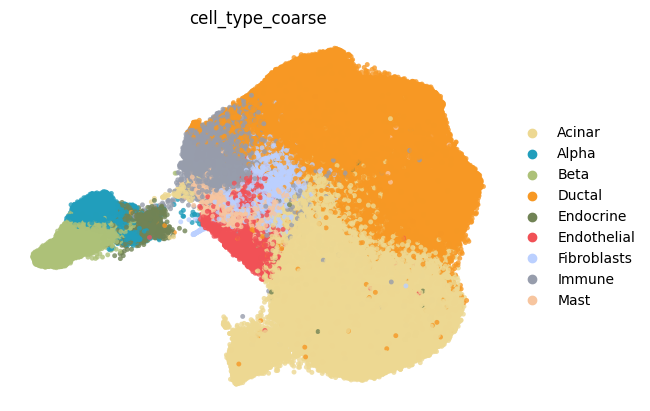

In [100]:
sc.pl.umap(
    adata_t1,
    color=['cell_type_coarse'],
    frameon=False,ncols=1,edges_color=True,size=50,alpha=.8
)

In [145]:
adatas

[AnnData object with n_obs × n_vars = 108711 × 979
     obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes', 'cell_type_coarse'
     var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
     uns: 'log1p', 'spatial'
     obsm: 'spatial', 'spatial_fov'
     layers: 'counts',
 AnnData object with n_obs × n_vars = 126421 × 979
     obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_glo

### Save annotation labels in anndata objects

In [131]:
for s in adata_nd.obs['slide'].cat.categories:
    df_nd = pd.DataFrame(adata_nd[np.isin(adata_nd.obs['slide'],[s]),:].obs['cell_type_coarse'])
    df_t1 = pd.DataFrame(adata_t1[np.isin(adata_t1.obs['slide'],[s]),:].obs['cell_type_coarse'])
    
    df_nd.index = df_nd.index.str.replace('-'+s,'')
    df_t1.index = df_t1.index.str.replace('-'+s,'')
    
    df = pd.concat([df_nd, df_t1], axis=0)

    s_int = int(s)
    adatas[s_int].obs['cell_type_coarse'] = ''
    for i in adatas[s_int].obs_names:
        adatas[s_int].obs.loc[i,'cell_type_coarse'] = df.loc[i,'cell_type_coarse']
adatas

[AnnData object with n_obs × n_vars = 108711 × 979
     obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes', 'cell_type_coarse'
     var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
     uns: 'log1p', 'spatial'
     obsm: 'spatial', 'spatial_fov'
     layers: 'counts',
 AnnData object with n_obs × n_vars = 126421 × 979
     obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_glo

In [146]:
for s in adata_nd.obs['slide'].cat.categories:
    s_int = int(s)
    adatas[s_int].write(folder+'S'+str(s_int+1)+'_annotated_l0.h5ad')

In [147]:
folder

'../../../../../../datasets/projects/20230301_Sander_SpatialPancreas_sara.jimenez/spatial/'

### Integrate the whole object

In [148]:
adata

AnnData object with n_obs × n_vars = 386727 × 979
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes'
    var: 'NegPrb', 'n_cells_by_counts-0', 'mean_counts-0', 'log1p_mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'log1p_total_counts-0', 'n_cells-0', 'n_cells_by_counts-1', 'mean_counts-1', 'log1p_mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'log1p_total_counts-1', 'n_cells-1', 'n_cells_by_counts-2', 'mean_counts-2', 'log1p_mean_counts-2', 'pct_dropout

In [149]:
adata.raw = adata
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=2000,
    subset=True,
    layer='counts',
    flavor='seurat_v3',
    batch_key='slide',
)

In [150]:
scvi.model.SCVI.setup_anndata(
    adata,
    layer='counts',
    categorical_covariate_keys=['slide','condition']
)

model = scvi.model.SCVI(adata)

model.train()

latent = model.get_latent_representation()

adata.obsm['X_scVI'] = latent

adata.layers['scvi_normalized'] = model.get_normalized_expression(library_size=10e4)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
SLURM auto-requeueing enabled. Setting signal handlers.
/home/aih/sara.jimenez/miniconda3/envs/scvi-env/lib/python3.9/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=3` in the `DataLoader` to improve performance.


Epoch 21/21: 100%|██████████| 21/21 [06:23<00:00, 17.91s/it, v_num=1, train_loss_step=289, train_loss_epoch=283]

`Trainer.fit` stopped: `max_epochs=21` reached.


Epoch 21/21: 100%|██████████| 21/21 [06:23<00:00, 18.24s/it, v_num=1, train_loss_step=289, train_loss_epoch=283]


In [ ]:
sc.pp.neighbors(adata, use_rep='X_scVI')
sc.tl.umap(adata_, min_dist=0.3)

sc.pl.umap(
    adata_nd,
    color=['slide','INS','GCG','SOX9','EGF','CD4'],
    ncols=3,size=50,vmin=1.0,vmax='p99',alpha=0.3,frameon=False,cmap='RdYlBu_r'
)